In [382]:
from pycocotools.coco import COCO

annotation = '/data/coco/annotations/instances_val2014.json'
dataset = COCO(annotation)

loading annotations into memory...
Done (t=2.31s)
creating index...
index created!


In [383]:
print(len(dataset.anns))
key = list(dataset.anns.keys())[0]
ann = dataset.anns[key]
print(ann)
print(dataset.imgs[ann['image_id']])
print(dataset.cats)


291875
{'segmentation': [[239.97, 260.24, 222.04, 270.49, 199.84, 253.41, 213.5, 227.79, 259.62, 200.46, 274.13, 202.17, 277.55, 210.71, 249.37, 253.41, 237.41, 264.51, 242.54, 261.95, 228.87, 271.34]], 'area': 2765.1486500000005, 'iscrowd': 0, 'image_id': 558840, 'bbox': [199.84, 200.46, 77.71, 70.88], 'category_id': 58, 'id': 156}
{'license': 1, 'file_name': 'COCO_val2014_000000558840.jpg', 'coco_url': 'http://images.cocodataset.org/val2014/COCO_val2014_000000558840.jpg', 'height': 427, 'width': 640, 'date_captured': '2013-11-15 06:55:40', 'flickr_url': 'http://farm5.staticflickr.com/4045/4488509035_29a34e4f32_z.jpg', 'id': 558840}
{1: {'supercategory': 'person', 'id': 1, 'name': 'person'}, 2: {'supercategory': 'vehicle', 'id': 2, 'name': 'bicycle'}, 3: {'supercategory': 'vehicle', 'id': 3, 'name': 'car'}, 4: {'supercategory': 'vehicle', 'id': 4, 'name': 'motorcycle'}, 5: {'supercategory': 'vehicle', 'id': 5, 'name': 'airplane'}, 6: {'supercategory': 'vehicle', 'id': 6, 'name': 'bus'

(50, 50)


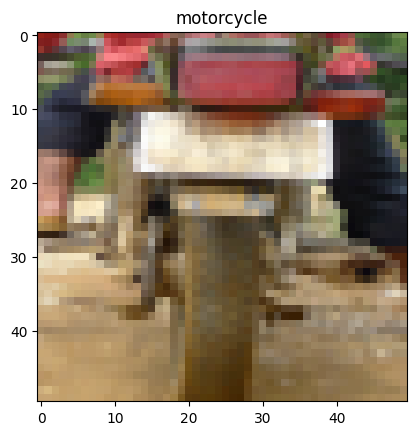

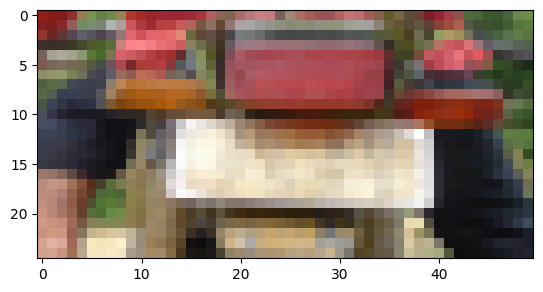

(50, 50)


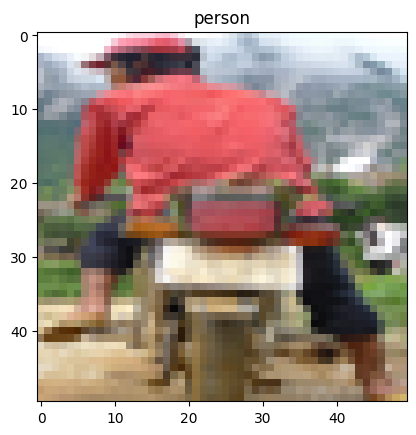

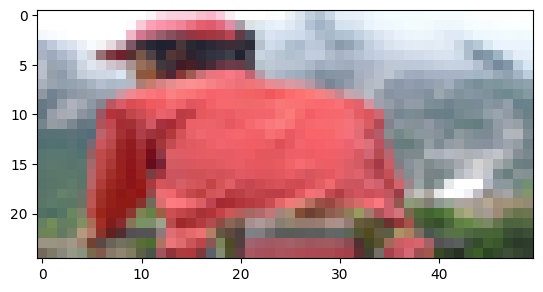

(50, 50)


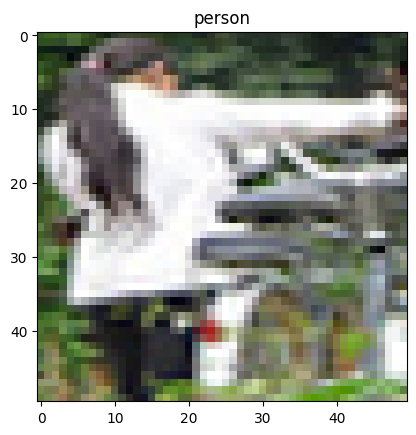

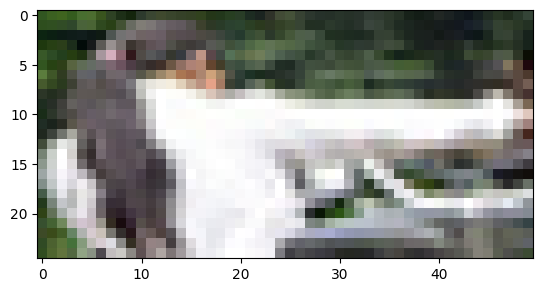

In [384]:
import matplotlib.pyplot as plt
from PIL import Image

def crop_by_bbox(img, bbox):
    x, y, w, h = bbox
    return img[y:y+h, x:x+w]

def crop_by_bbox_pil(img, bbox):
    x, y, w, h = bbox
    return img.crop((x, y, x+w, y+h))

LIMIT = 3
i = 0
TARGET_DIM = (50,50)

for img_data in dataset.imgs.values():
     
    img_name = img_data['file_name']
    img_id = img_data['id']
    if img_id not in dataset.imgToAnns:
        continue

    img_ann = dataset.imgToAnns[img_id]

    # img = plt.imread('/data/coco/val2014/{}'.format(img_name))
    img = Image.open('/data/coco/val2014/{}'.format(img_name))
    for ann in img_ann:
        if 'bbox' not in ann:
            continue
        bbox = [int(d) for d in ann['bbox']]
        label = dataset.cats[ann['category_id']]['name']
        # cropped_img = crop_by_bbox(img, bbox)
        cropped_img = crop_by_bbox_pil(img, bbox)
        cropped_img = cropped_img.resize(TARGET_DIM)

        top_half = cropped_img.crop((0, 0, TARGET_DIM[0], TARGET_DIM[1]//2))
        print(cropped_img.size)
        plt.title(label)
        plt.imshow(cropped_img)
        plt.show()
        plt.imshow(top_half)
        plt.show()

        i += 1
        if i >= LIMIT:
            break

    if i >= LIMIT:
        break

In [410]:
import numpy as np
from sklearn.cluster import KMeans

# Write a function that takes in a list of images and draws them in a grid
def draw_images(images, rows, cols):
    fig = plt.figure(figsize=(10, 10))
    for i in range(1, rows*cols + 1):
        fig.add_subplot(rows, cols, i)
        plt.imshow(images[i-1])

    axes = fig.get_axes()
    for ax in axes:
        ax.axis('off')
        
    plt.show()

def process_img_square(img, target_dim):
    img = img.resize(target_dim)
    # return np.array(img)
    return np.array(img)

TARGET_DIM = (50,50)
cat = 10
img_list = []
n_imgs = 5000
anns = dataset.getAnnIds(catIds=[cat])[:n_imgs]
prev_shape = None

for a_id in anns:
    
    ann = dataset.anns[a_id]
    if 'bbox' not in ann:
        continue

    bbox = [int(d) for d in ann['bbox']]
    label = dataset.cats[ann['category_id']]['name']
    img_name = dataset.imgs[ann['image_id']]['file_name']
    img = Image.open('/data/coco/val2014/{}'.format(img_name)).convert('RGB')
    # cropped_img = crop_by_bbox(img, bbox)
    cropped_img = crop_by_bbox_pil(img, bbox)
    cropped_img = process_img_square(cropped_img, TARGET_DIM)
    img_list.append(cropped_img.flatten())

    if prev_shape is None:
        prev_shape = cropped_img.shape
    else:
        assert prev_shape == cropped_img.shape, 'Shape mismatch: {} vs {}'.format(prev_shape, cropped_img.shape)

    # top_half = cropped_img.crop((0, 0, TARGET_DIM[0], TARGET_DIM[1]//2))

    if len(img_list) >= n_imgs:
        break

In [411]:
# normalize the image data according to average pixel value
img_list = np.array(img_list)
img_list_norm = (img_list - img_list.mean()) / img_list.std()



In [412]:
# run kmeans on img list

kmeans = KMeans(n_clusters=4, random_state=0).fit_predict(img_list_norm)
print(kmeans)

/nethome/jxu680/miniconda3/envs/slice-bench/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[2 3 1 ... 1 1 0]


In [419]:
import umap
from sklearn.cluster import DBSCAN

u = umap.UMAP(n_components=10).fit_transform(img_list_norm)
u_norm = (u - u.mean()) / u.std()
kmeans_u = KMeans(n_clusters=10, random_state=0).fit_predict(u_norm)

/nethome/jxu680/miniconda3/envs/slice-bench/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [414]:
import umap
from sklearn.cluster import DBSCAN

# img_list_norm_quarter = img_list_norm[:, -3*img_list_norm.shape[1]//4:]
img_list_norm_quarter = img_list_norm[:, :img_list_norm.shape[1]//4]
u = umap.UMAP(n_components=10).fit_transform(img_list_norm_quarter)
u_norm = (u - u.mean()) / u.std()
kmeans_u = KMeans(n_clusters=10, random_state=0).fit_predict(u_norm)

/nethome/jxu680/miniconda3/envs/slice-bench/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [420]:
from collections import Counter
import hdbscan

print(u_norm.shape)
# db_u = DBSCAN(eps=0.5, min_samples=2).fit_predict(u_norm)
min_cluster = int(.01 * len(u_norm))
print(min_cluster)
hdb_u = hdbscan.HDBSCAN(min_cluster_size=min_cluster, cluster_selection_method='leaf').fit_predict(u_norm)
print(Counter(hdb_u))

(4362, 10)
43
Counter({-1: 2445, 3: 910, 6: 264, 5: 180, 4: 149, 0: 134, 2: 124, 1: 83, 7: 73})


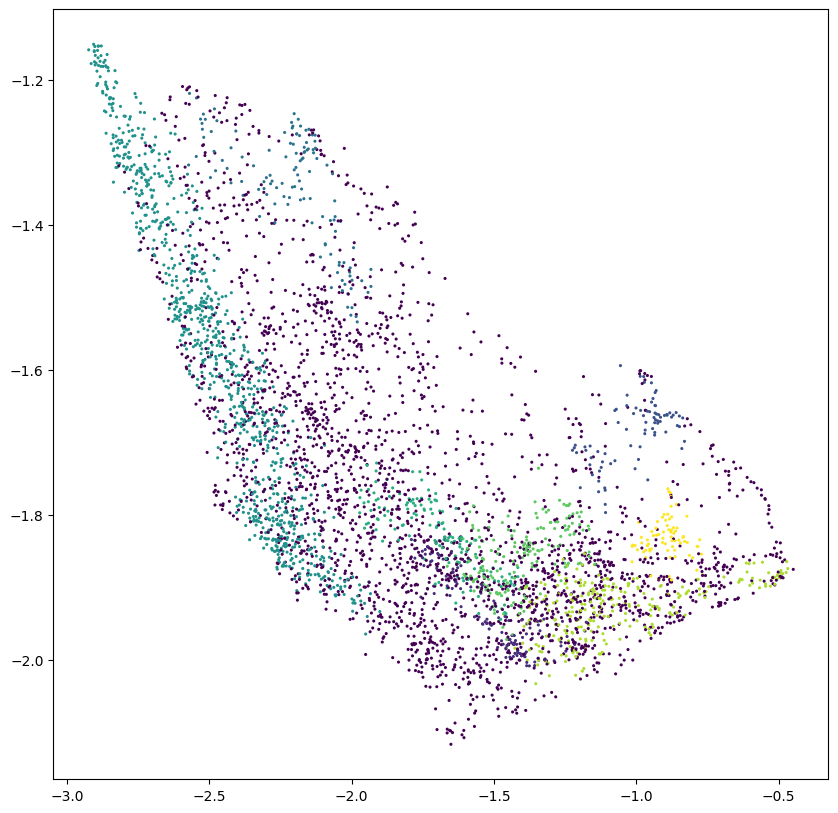

In [421]:
# plot u_norm
plt.figure(figsize=(10,10))
plt.scatter(u_norm[:,0], u_norm[:,1], c=hdb_u, s=1.5)

In [422]:
# pick the two highest quality clusters based on quality metric avg silhouette score
from collections import Counter

def get_cluster_quality(X, labels):
    from sklearn.metrics import silhouette_samples
    sample_silhouette_values = silhouette_samples(X, labels)
    return np.mean(sample_silhouette_values)

def get_top_clusters(X, labels, n=2):
    scores = Counter()
    for label in set(labels):
        scores[label] = get_cluster_quality(X, labels == label)
    
    print(scores, scores.most_common(n))
    return scores.most_common(n)

top_clusters = get_top_clusters(img_list_norm, kmeans, n=4)
top_clusters_u = get_top_clusters(u_norm, kmeans_u, n=4)
top_clusters_hu = get_top_clusters(u_norm, hdb_u, n=4)
print(top_clusters, top_clusters_u)



Counter({0: 0.29351530298737627, 3: 0.16199685550755033, 2: 0.09392626788898496, 1: 0.04864373780288032}) [(0, 0.29351530298737627), (3, 0.16199685550755033), (2, 0.09392626788898496), (1, 0.04864373780288032)]
Counter({9: 0.28457987, 3: 0.26636732, 7: 0.159225, 1: 0.14248738, 2: 0.081951395, 5: 0.02206438, 6: 0.0027375217, 8: -0.004250525, 0: -0.03575163, 4: -0.07712235}) [(9, 0.28457987), (3, 0.26636732), (7, 0.159225), (1, 0.14248738)]
Counter({3: 0.21664175, 7: 0.15432757, 1: 0.14527412, 6: 0.12678443, -1: 0.041606024, 0: -0.00069612893, 2: -0.00864749, 4: -0.027203538, 5: -0.036491334}) [(3, 0.21664175), (7, 0.15432757), (1, 0.14527412), (6, 0.12678443)]
[(0, 0.29351530298737627), (3, 0.16199685550755033), (2, 0.09392626788898496), (1, 0.04864373780288032)] [(9, 0.28457987), (3, 0.26636732), (7, 0.159225), (1, 0.14248738)]


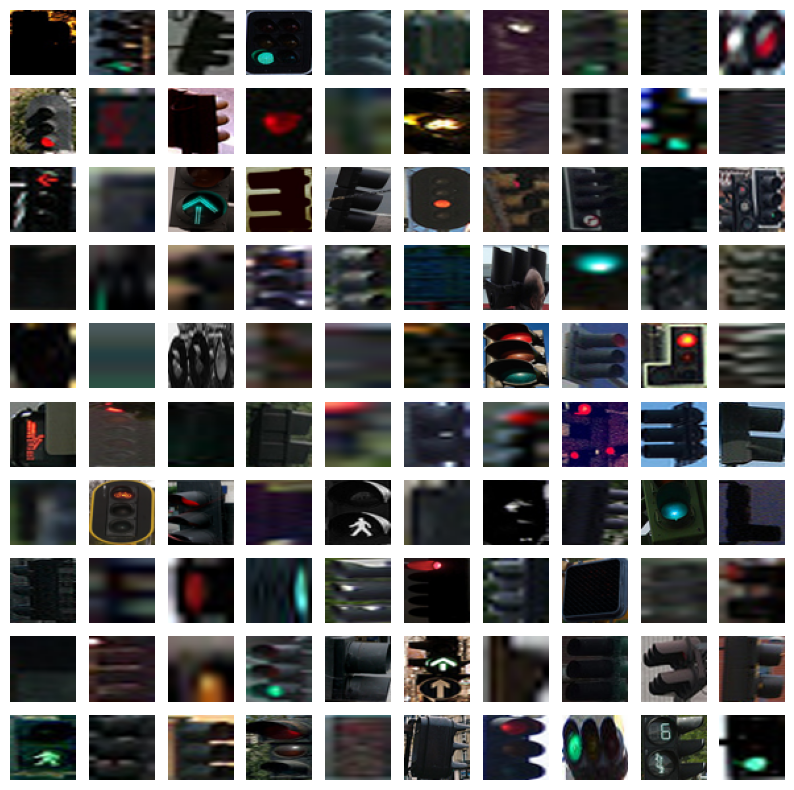

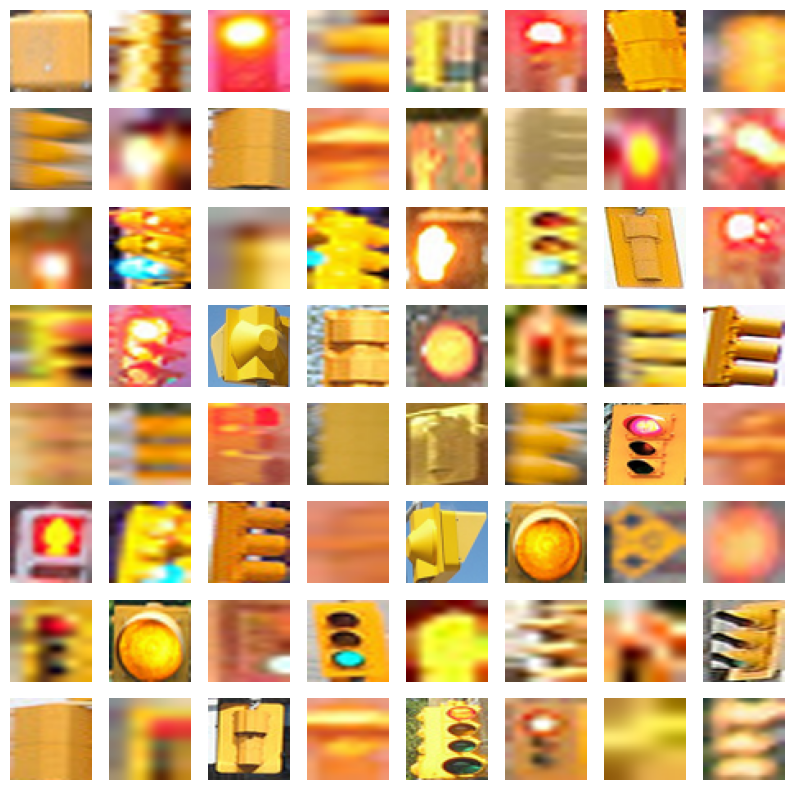

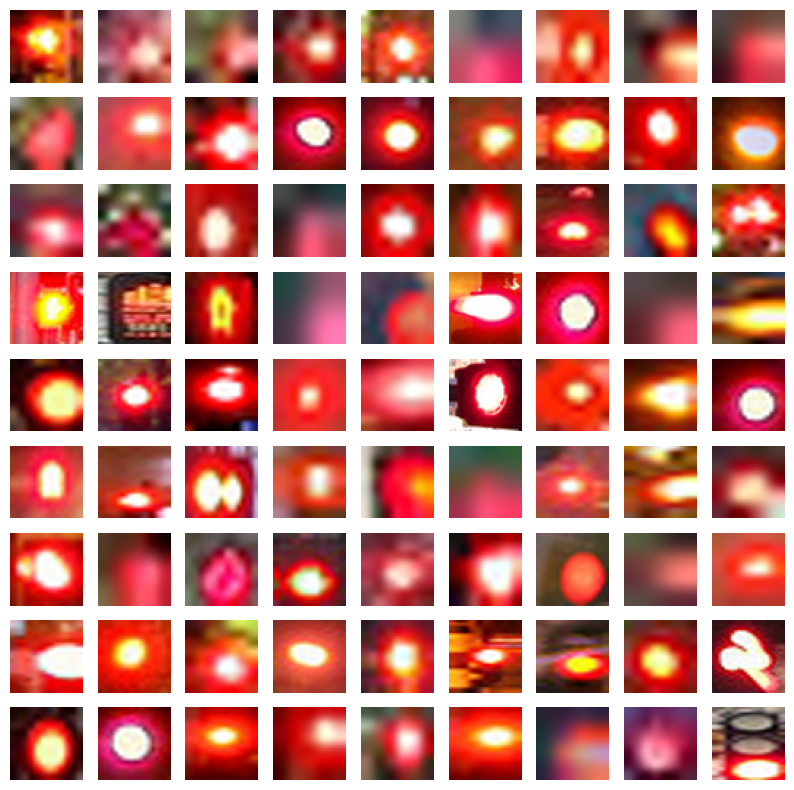

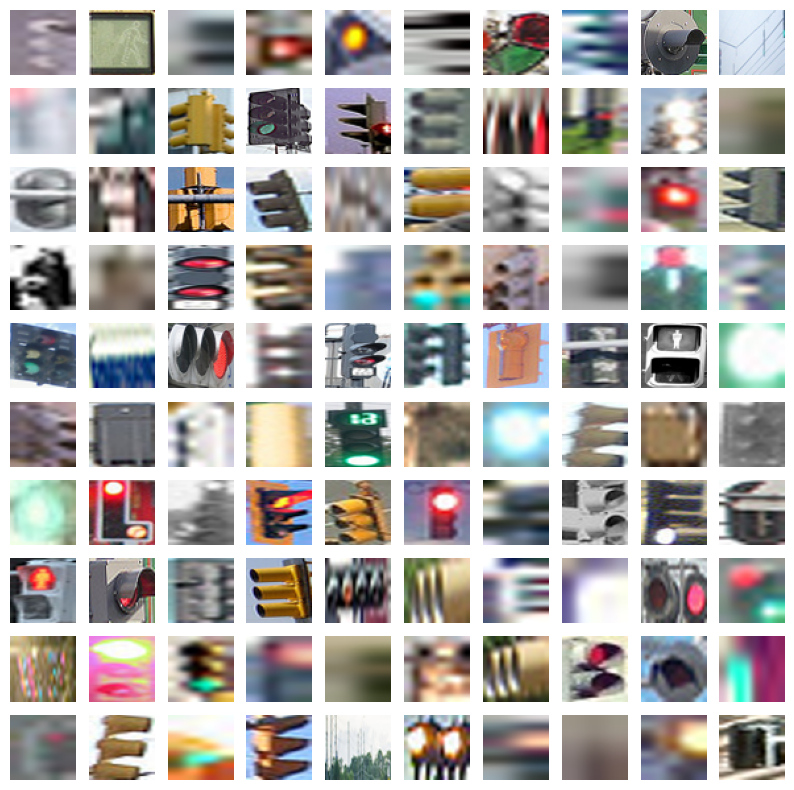

In [423]:
import math
n = 10

for (label, score) in top_clusters_hu:
    source = hdb_u
    idx = np.where(source == label)[0]
    n_size = math.floor(min(n, math.sqrt(len(idx))))
    idx = np.random.choice(idx, n_size**2, replace=False)
    draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in idx], n_size, n_size)

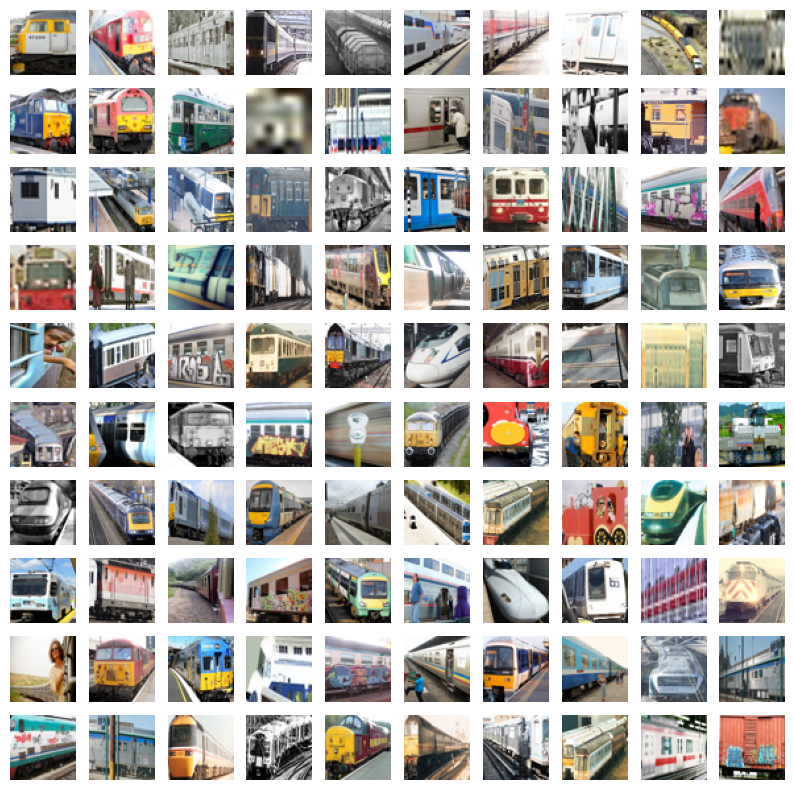

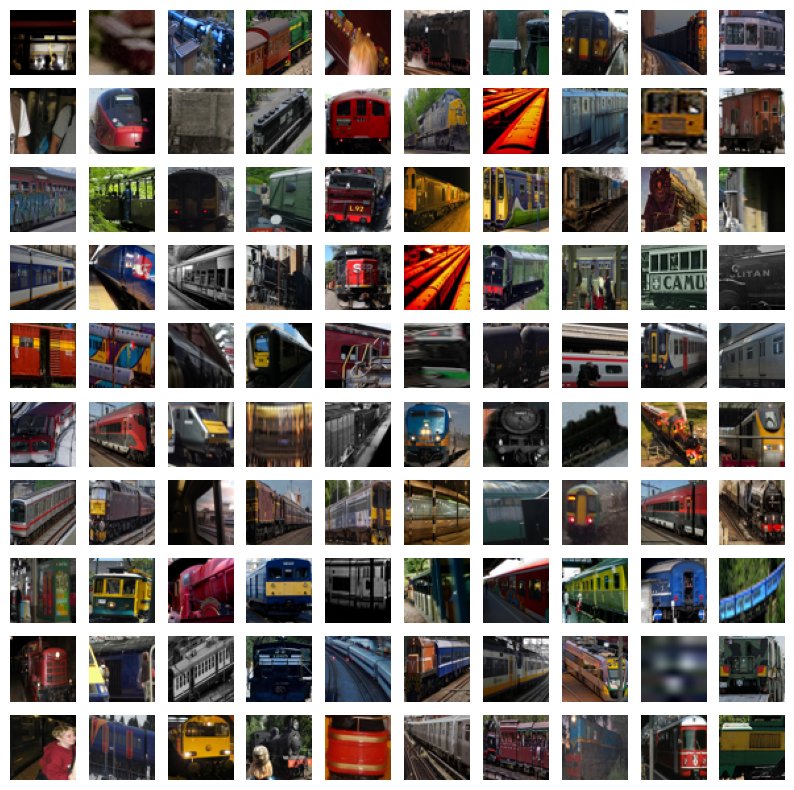

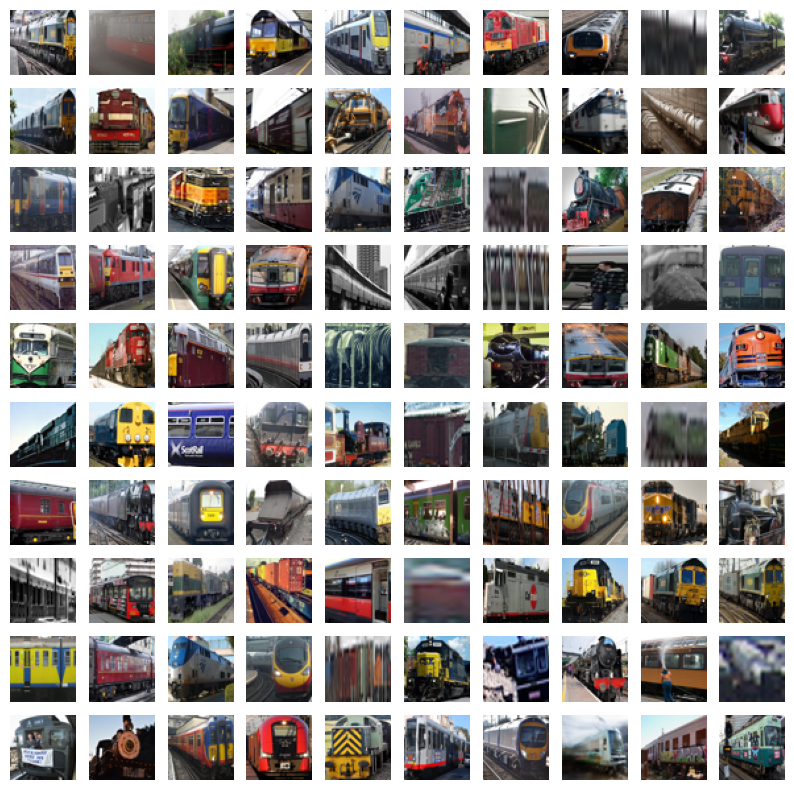

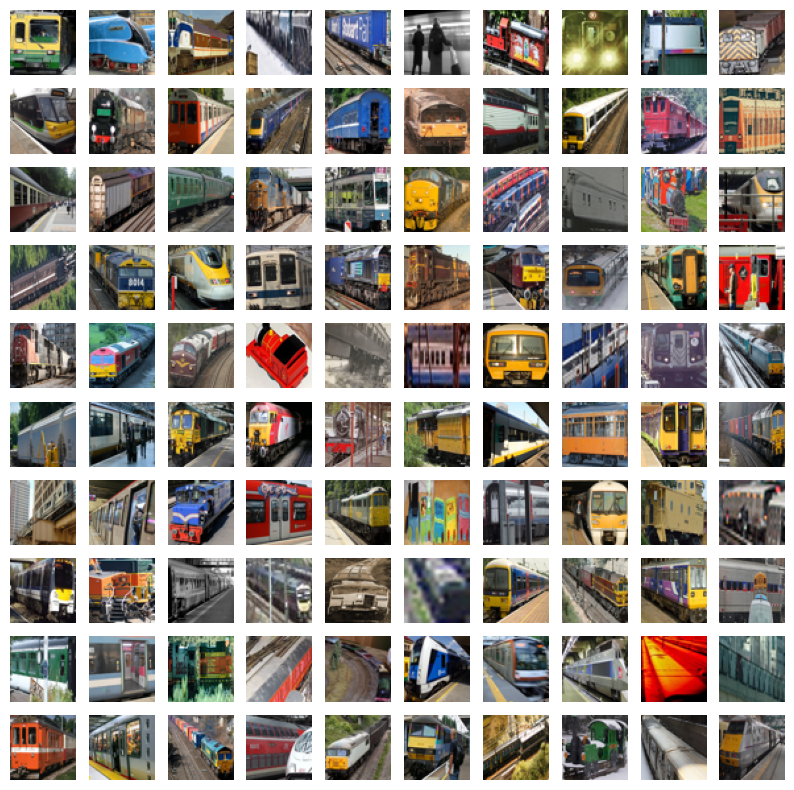

--------


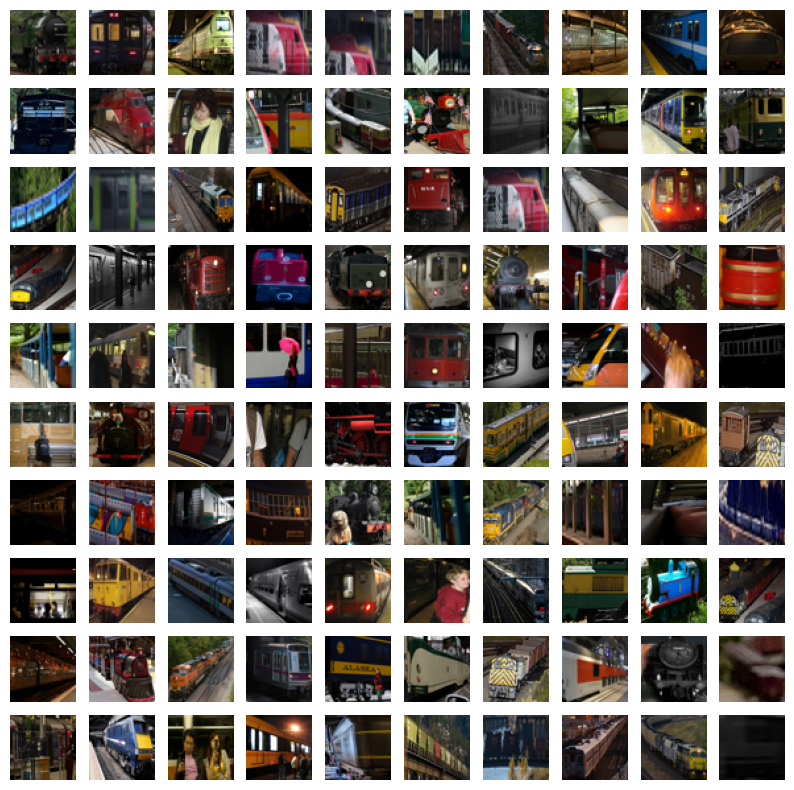

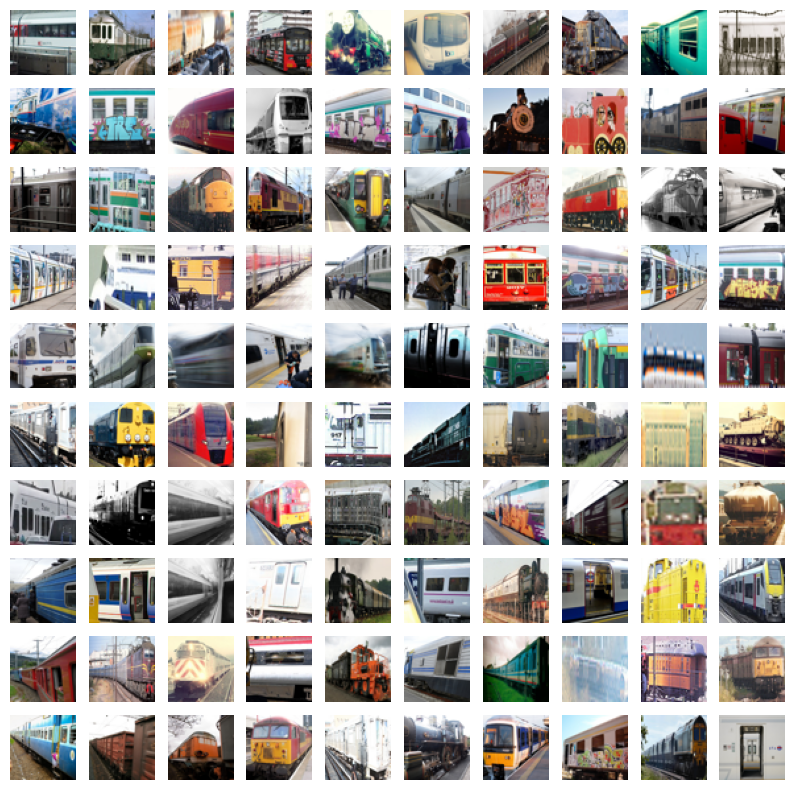

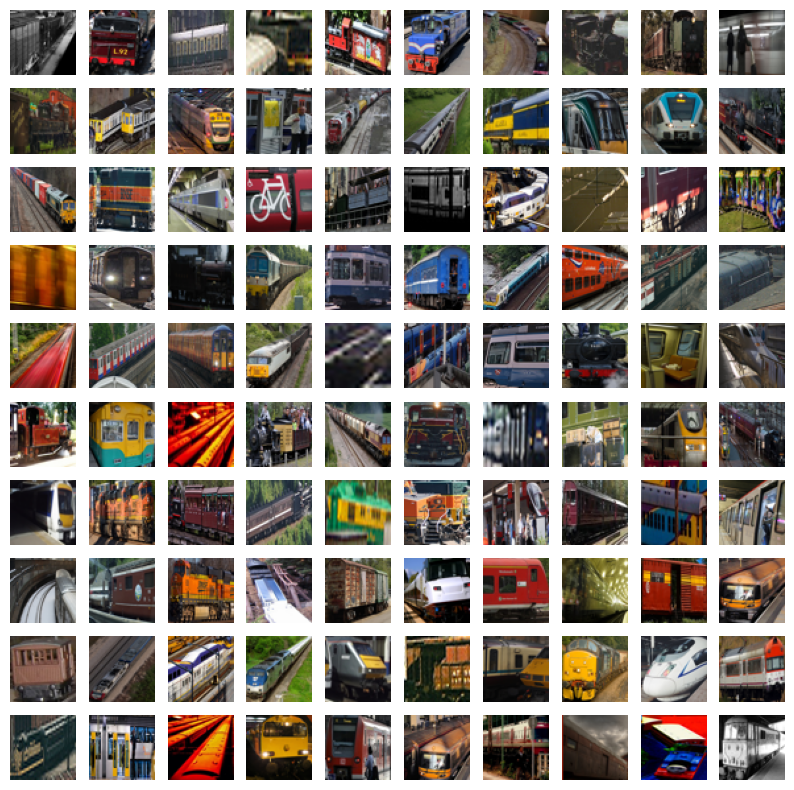

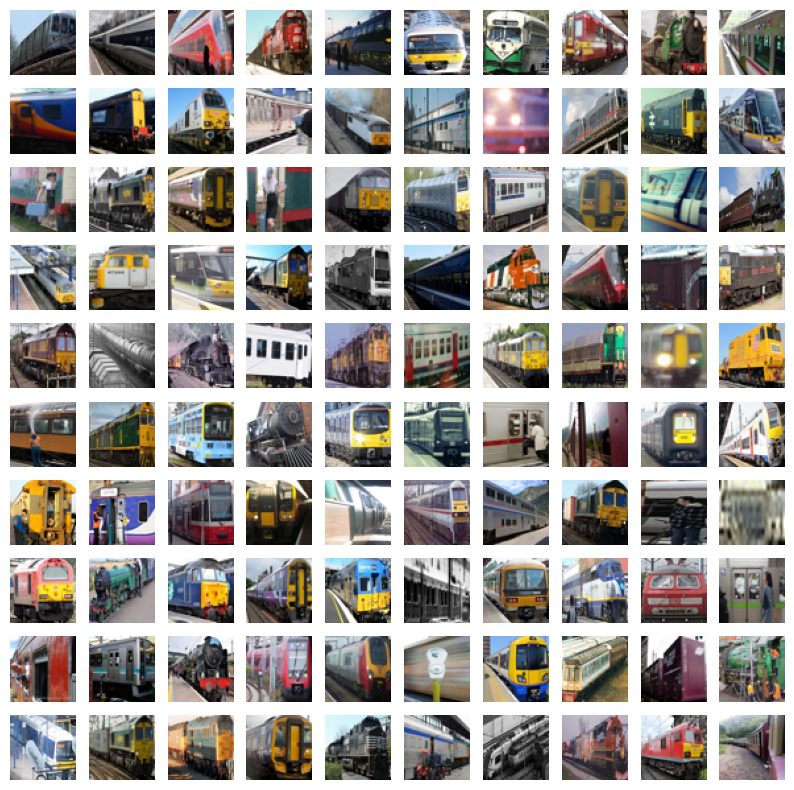

In [395]:
import math
n = 10

for (label, score) in top_clusters:
    source = kmeans
    idx = np.where(source == label)[0]
    n_size = math.floor(min(n, math.sqrt(len(idx))))
    idx = np.random.choice(idx, n_size**2, replace=False)
    draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in idx], n_size, n_size)

print('--------')

for (label, score) in top_clusters_u:
    source = kmeans_u
    idx = np.where(source == label)[0]
    n_size = math.floor(min(n, math.sqrt(len(idx))))
    idx = np.random.choice(idx, n_size**2, replace=False)
    draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in idx], n_size, n_size)

In [396]:
print(np.array(u).shape)

(1602, 5)


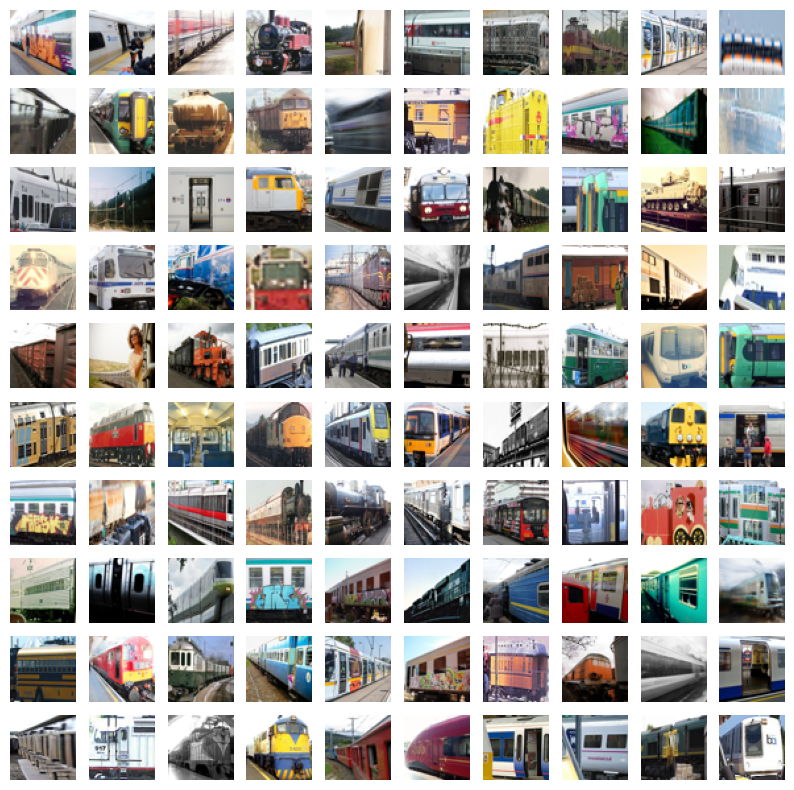

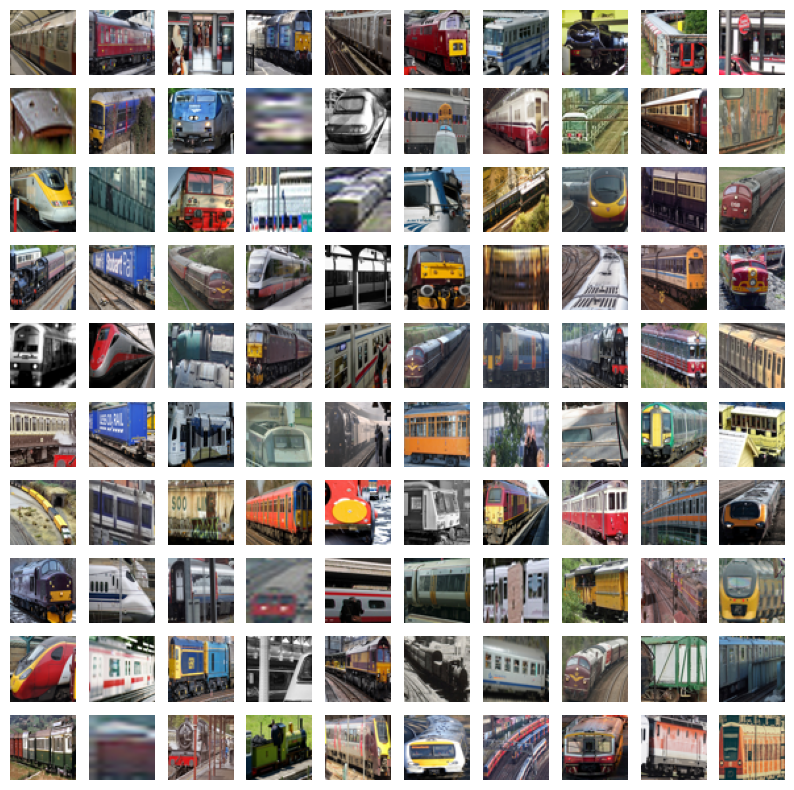

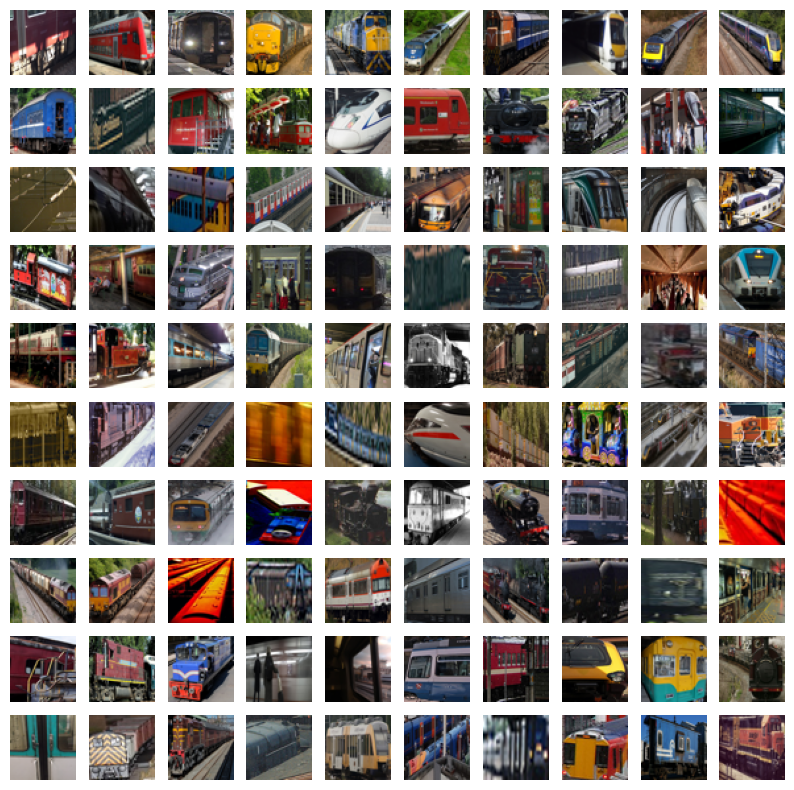

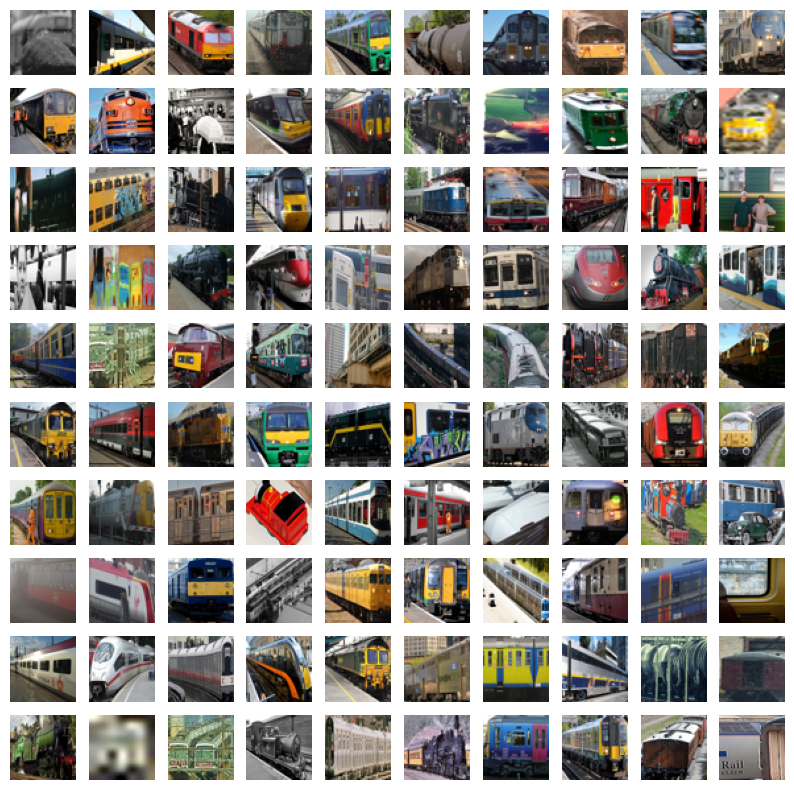

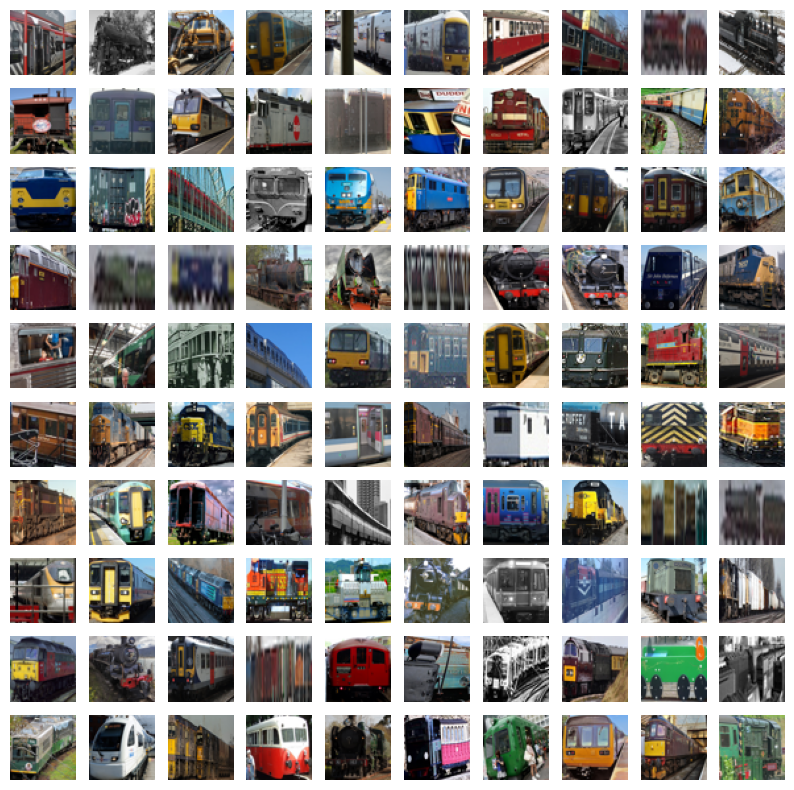

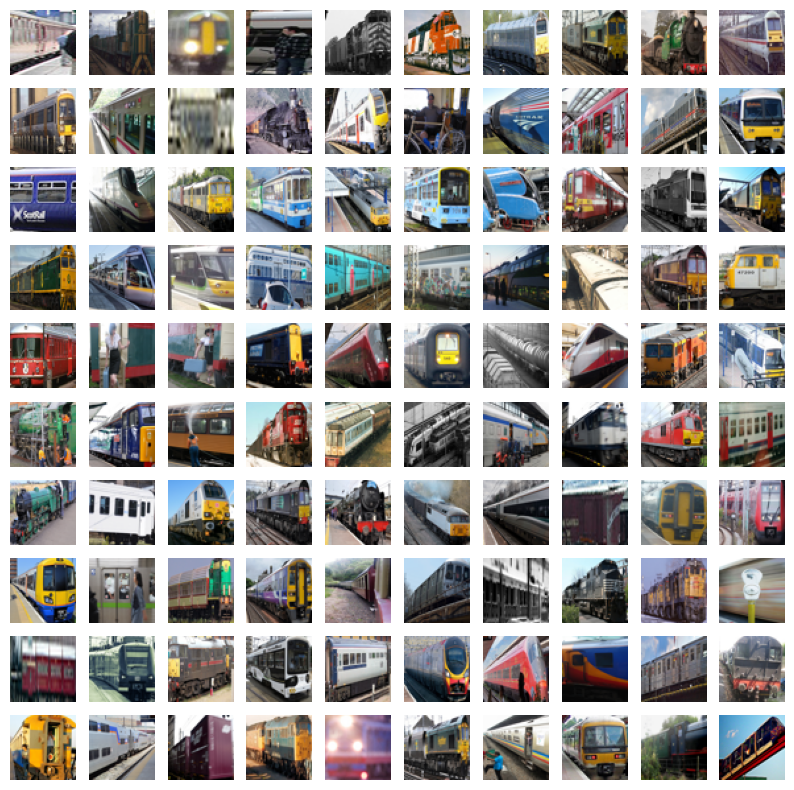

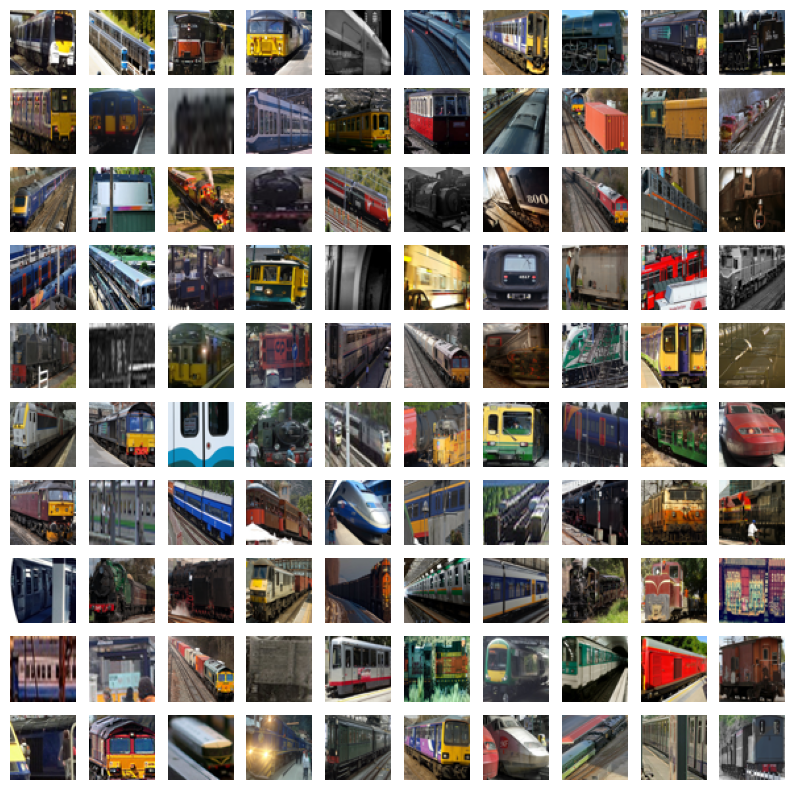

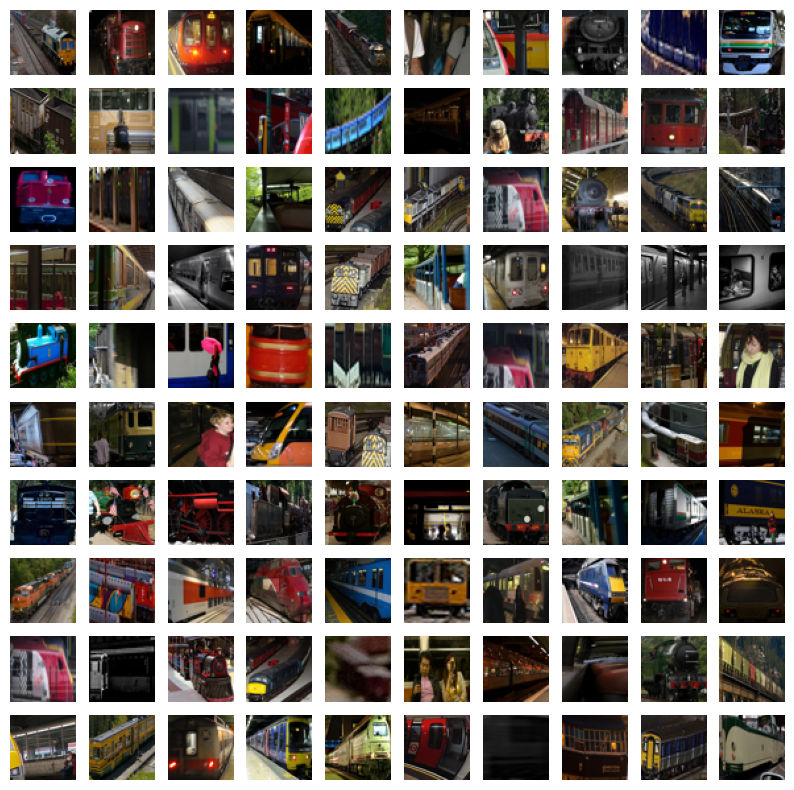

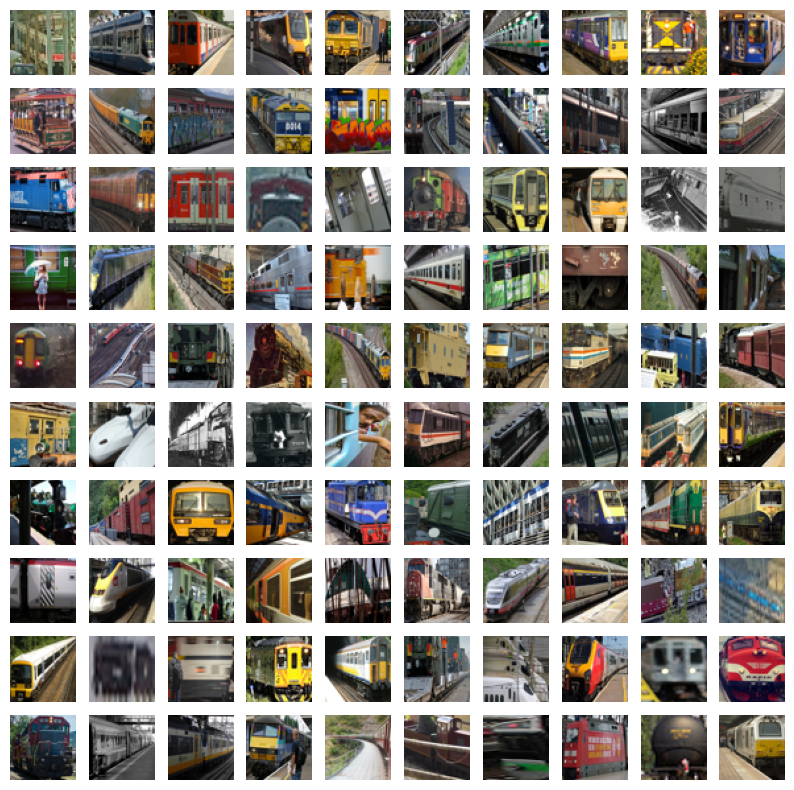

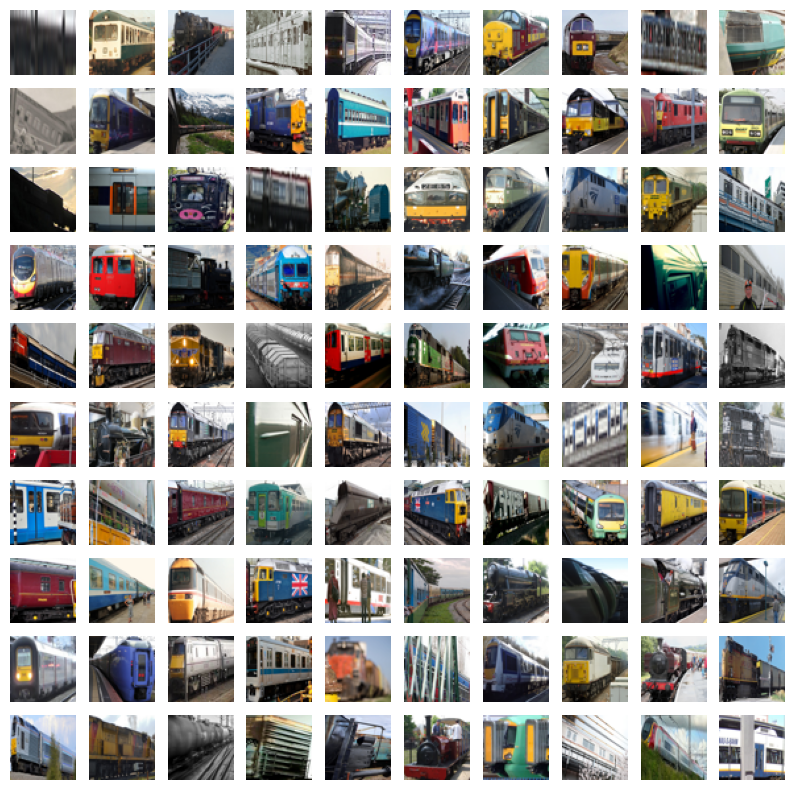

In [397]:
import math

source = kmeans_u
labels = np.unique(source)
n = 10

for label in labels:
    idx = np.where(source == label)[0]
    n_size = math.floor(min(n, math.sqrt(len(idx))))
    idx = np.random.choice(idx, n_size**2, replace=False)
    draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in idx], n_size, n_size)

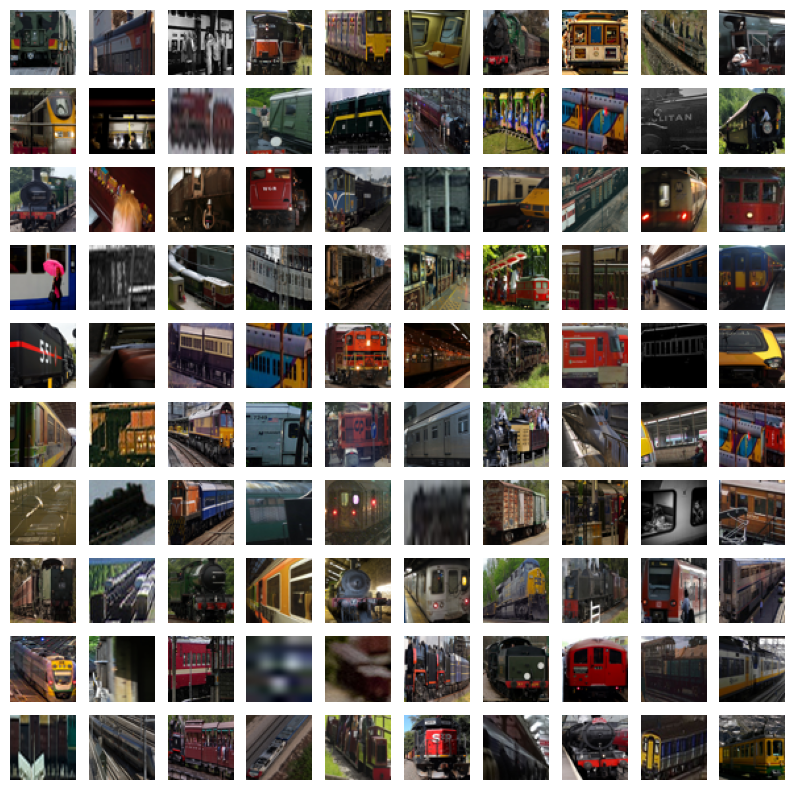

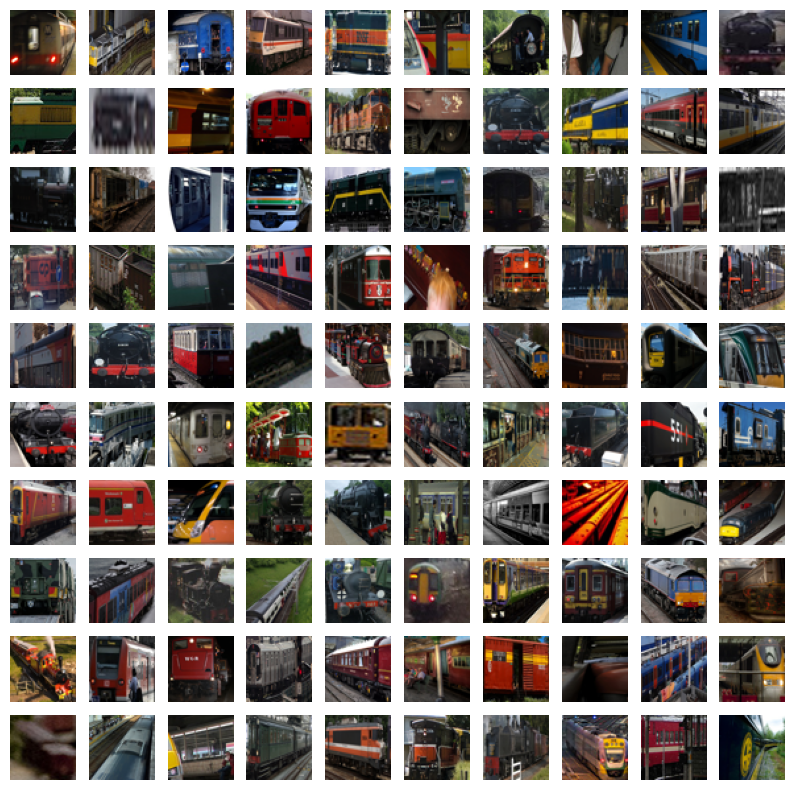

In [398]:
zero_labels = np.where(kmeans == 0)[0]
one_labels = np.where(kmeans == 1)[0]

x = 10

# choose 25 random indices from each cluster
rnd_1 = np.random.choice(zero_labels, x**2, replace=False)
rnd_2 = np.random.choice(zero_labels, x**2, replace=False)
zero_labels = rnd_1
one_labels = rnd_2

# plot 5 x 5 grid of images for both clusters
draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in zero_labels], x, x)
draw_images([Image.fromarray(img_list[i].reshape(*TARGET_DIM, 3)) for i in one_labels], x, x)